# Exploration of neural activity

This notebook explores the following features of the neural activity
       
- ISI Distribution
    - Histograms
    - Poisson Fano factor
    
    
- Firing rate
    - Estimated using
        - Boxcar
        - Smoothing with constant kernel
        - Smoothing with optimal kernel (see [optimal_gauss_kernel_size](https://spykeutils.readthedocs.io/en/0.4.1/apidoc/spykeutils.html))
    - Over
        - Baseline
        - Trial
    - Marginalized on
        - Trials
        - Times
        - Neurons
    - Normalized by
        - None
        - Baseline activity
        - Whole trial statistics
        - ? Window statistics


- Synchronicity, correlation, similarity
    - Measured by
        - cross-correlations (see [correlations](https://spykeutils.readthedocs.io/en/0.4.1/apidoc/spykeutils.html))
        - distances (see [distances](https://spykeutils.readthedocs.io/en/0.4.1/apidoc/spykeutils.html))


# Table of Contents
 <p><div class="lev1 toc-item"><a href="#Exploration-of-neural-activity" data-toc-modified-id="Exploration-of-neural-activity-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Exploration of neural activity</a></div><div class="lev1 toc-item"><a href="#Env-imports-and-settings" data-toc-modified-id="Env-imports-and-settings-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Env imports and settings</a></div><div class="lev2 toc-item"><a href="#Imports" data-toc-modified-id="Imports-21"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Imports</a></div><div class="lev2 toc-item"><a href="#Settings" data-toc-modified-id="Settings-22"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Settings</a></div><div class="lev1 toc-item"><a href="#Raw-data" data-toc-modified-id="Raw-data-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Raw data</a></div><div class="lev2 toc-item"><a href="#Number-of-neurons" data-toc-modified-id="Number-of-neurons-31"><span class="toc-item-num">3.1&nbsp;&nbsp;</span>Number of neurons</a></div><div class="lev2 toc-item"><a href="#Number-of-trials" data-toc-modified-id="Number-of-trials-32"><span class="toc-item-num">3.2&nbsp;&nbsp;</span>Number of trials</a></div><div class="lev2 toc-item"><a href="#Raster-plots" data-toc-modified-id="Raster-plots-33"><span class="toc-item-num">3.3&nbsp;&nbsp;</span>Raster plots</a></div><div class="lev3 toc-item"><a href="#TODO" data-toc-modified-id="TODO-331"><span class="toc-item-num">3.3.1&nbsp;&nbsp;</span>TODO</a></div><div class="lev3 toc-item"><a href="#DRRD-7" data-toc-modified-id="DRRD-7-332"><span class="toc-item-num">3.3.2&nbsp;&nbsp;</span>DRRD 7</a></div><div class="lev4 toc-item"><a href="#Selected" data-toc-modified-id="Selected-3321"><span class="toc-item-num">3.3.2.1&nbsp;&nbsp;</span>Selected</a></div><div class="lev4 toc-item"><a href="#Removed" data-toc-modified-id="Removed-3322"><span class="toc-item-num">3.3.2.2&nbsp;&nbsp;</span>Removed</a></div><div class="lev3 toc-item"><a href="#DRRD-8" data-toc-modified-id="DRRD-8-333"><span class="toc-item-num">3.3.3&nbsp;&nbsp;</span>DRRD 8</a></div><div class="lev4 toc-item"><a href="#Selected" data-toc-modified-id="Selected-3331"><span class="toc-item-num">3.3.3.1&nbsp;&nbsp;</span>Selected</a></div><div class="lev4 toc-item"><a href="#Removed" data-toc-modified-id="Removed-3332"><span class="toc-item-num">3.3.3.2&nbsp;&nbsp;</span>Removed</a></div><div class="lev3 toc-item"><a href="#DRRD-9" data-toc-modified-id="DRRD-9-334"><span class="toc-item-num">3.3.4&nbsp;&nbsp;</span>DRRD 9</a></div><div class="lev4 toc-item"><a href="#Selected" data-toc-modified-id="Selected-3341"><span class="toc-item-num">3.3.4.1&nbsp;&nbsp;</span>Selected</a></div><div class="lev4 toc-item"><a href="#Removed" data-toc-modified-id="Removed-3342"><span class="toc-item-num">3.3.4.2&nbsp;&nbsp;</span>Removed</a></div><div class="lev3 toc-item"><a href="#DRRD-10" data-toc-modified-id="DRRD-10-335"><span class="toc-item-num">3.3.5&nbsp;&nbsp;</span>DRRD 10</a></div><div class="lev4 toc-item"><a href="#Selected" data-toc-modified-id="Selected-3351"><span class="toc-item-num">3.3.5.1&nbsp;&nbsp;</span>Selected</a></div><div class="lev4 toc-item"><a href="#Removed" data-toc-modified-id="Removed-3352"><span class="toc-item-num">3.3.5.2&nbsp;&nbsp;</span>Removed</a></div><div class="lev3 toc-item"><a href="#Autoshape-7" data-toc-modified-id="Autoshape-7-336"><span class="toc-item-num">3.3.6&nbsp;&nbsp;</span>Autoshape 7</a></div><div class="lev3 toc-item"><a href="#Autoshape-8" data-toc-modified-id="Autoshape-8-337"><span class="toc-item-num">3.3.7&nbsp;&nbsp;</span>Autoshape 8</a></div><div class="lev3 toc-item"><a href="#Autoshape-9" data-toc-modified-id="Autoshape-9-338"><span class="toc-item-num">3.3.8&nbsp;&nbsp;</span>Autoshape 9</a></div><div class="lev3 toc-item"><a href="#Autoshape-10" data-toc-modified-id="Autoshape-10-339"><span class="toc-item-num">3.3.9&nbsp;&nbsp;</span>Autoshape 10</a></div><div class="lev2 toc-item"><a href="#Interspike-Intervals" data-toc-modified-id="Interspike-Intervals-34"><span class="toc-item-num">3.4&nbsp;&nbsp;</span>Interspike Intervals</a></div><div class="lev3 toc-item"><a href="#DRRD-7" data-toc-modified-id="DRRD-7-341"><span class="toc-item-num">3.4.1&nbsp;&nbsp;</span>DRRD 7</a></div><div class="lev3 toc-item"><a href="#DRRD-8" data-toc-modified-id="DRRD-8-342"><span class="toc-item-num">3.4.2&nbsp;&nbsp;</span>DRRD 8</a></div><div class="lev3 toc-item"><a href="#DRRD-9" data-toc-modified-id="DRRD-9-343"><span class="toc-item-num">3.4.3&nbsp;&nbsp;</span>DRRD 9</a></div><div class="lev3 toc-item"><a href="#DRRD-10" data-toc-modified-id="DRRD-10-344"><span class="toc-item-num">3.4.4&nbsp;&nbsp;</span>DRRD 10</a></div><div class="lev3 toc-item"><a href="#Autoshape-7" data-toc-modified-id="Autoshape-7-345"><span class="toc-item-num">3.4.5&nbsp;&nbsp;</span>Autoshape 7</a></div><div class="lev3 toc-item"><a href="#Autoshape-8" data-toc-modified-id="Autoshape-8-346"><span class="toc-item-num">3.4.6&nbsp;&nbsp;</span>Autoshape 8</a></div><div class="lev3 toc-item"><a href="#Autoshape-9" data-toc-modified-id="Autoshape-9-347"><span class="toc-item-num">3.4.7&nbsp;&nbsp;</span>Autoshape 9</a></div><div class="lev3 toc-item"><a href="#Autoshape-10" data-toc-modified-id="Autoshape-10-348"><span class="toc-item-num">3.4.8&nbsp;&nbsp;</span>Autoshape 10</a></div><div class="lev2 toc-item"><a href="#Time-resolved-analysis" data-toc-modified-id="Time-resolved-analysis-35"><span class="toc-item-num">3.5&nbsp;&nbsp;</span>Time-resolved analysis</a></div><div class="lev3 toc-item"><a href="#Duration" data-toc-modified-id="Duration-351"><span class="toc-item-num">3.5.1&nbsp;&nbsp;</span>Duration</a></div><div class="lev2 toc-item"><a href="#Firing-rate" data-toc-modified-id="Firing-rate-36"><span class="toc-item-num">3.6&nbsp;&nbsp;</span>Firing rate</a></div><div class="lev3 toc-item"><a href="#Per-neuron" data-toc-modified-id="Per-neuron-361"><span class="toc-item-num">3.6.1&nbsp;&nbsp;</span>Per neuron</a></div><div class="lev3 toc-item"><a href="#Baseline" data-toc-modified-id="Baseline-362"><span class="toc-item-num">3.6.2&nbsp;&nbsp;</span>Baseline</a></div><div class="lev3 toc-item"><a href="#Per-trial" data-toc-modified-id="Per-trial-363"><span class="toc-item-num">3.6.3&nbsp;&nbsp;</span>Per trial</a></div><div class="lev3 toc-item"><a href="#Per-time" data-toc-modified-id="Per-time-364"><span class="toc-item-num">3.6.4&nbsp;&nbsp;</span>Per time</a></div><div class="lev1 toc-item"><a href="#Synchronicity" data-toc-modified-id="Synchronicity-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Synchronicity</a></div><div class="lev2 toc-item"><a href="#Cross-correlation" data-toc-modified-id="Cross-correlation-41"><span class="toc-item-num">4.1&nbsp;&nbsp;</span>Cross-correlation</a></div><div class="lev2 toc-item"><a href="#Distances" data-toc-modified-id="Distances-42"><span class="toc-item-num">4.2&nbsp;&nbsp;</span>Distances</a></div><div class="lev3 toc-item"><a href="#ISI-Distance" data-toc-modified-id="ISI-Distance-421"><span class="toc-item-num">4.2.1&nbsp;&nbsp;</span>ISI-Distance</a></div><div class="lev3 toc-item"><a href="#Spike-Distance" data-toc-modified-id="Spike-Distance-422"><span class="toc-item-num">4.2.2&nbsp;&nbsp;</span>Spike-Distance</a></div>

# Env imports and settings

## Imports

In [1]:
# Data manipulation
import numpy as np
import pandas as pd

# Plotting
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
%matplotlib inline

# spikelearn
import os
os.chdir('../../')
import sys
sys.path.append('.')

from spikelearn.dataprocessing import io
from spikelearn.dataprocessing.selection import select
from spikelearn.visuals.visuals import raster_multiple, raster_plot

# Interaction

## Settings

In [2]:
# Definitions
DRRD_RATS = ['DRRD 7','DRRD 8','DRRD 9','DRRD 10']
AUTOSHAPE_RATS = ['Autoshape 7','Autoshape 8','Autoshape 9','Autoshape 10']
ALL_RATS = DRRD_RATS + AUTOSHAPE_RATS

# Facilitators
BASE_FIG_SIZE = np.array([20, 4])
mpl.rc("figure", figsize=BASE_FIG_SIZE)
per_rat_plot = lambda nplots, rats: plt.subplots(nplots, len(rats), sharey=True, figsize=BASE_FIG_SIZE*[1, nplots])
# example: fig, axes = per_rat_plot(4)

# Raw data

## Number of neurons

In [16]:
spk_sorted = [io.load(rat, 'spikes').shape[0] for rat in ALL_RATS]
manual = [io.load(rat, 'selected_neurons').shape[0] if io.dataset_exist(rat,'selected_neurons') else 0 for rat in ALL_RATS]

n_neurons = pd.DataFrame({'spike sorted':spk_sorted, 'manually selected':manual}, index=pd.Index(ALL_RATS, name='Label'))
n_neurons = n_neurons.reset_index().melt(id_vars = 'Label')

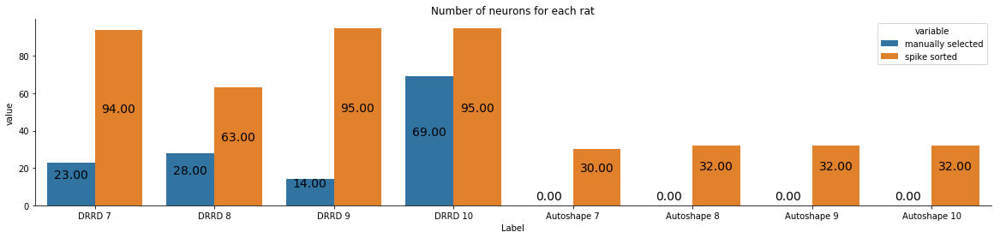

In [18]:
ax = sns.barplot(x='Label',y='value',hue='variable', data=n_neurons)

# Put numbers in bars
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height/2 + 3,
            '{:1.2f}'.format(height),
            ha="center", fontsize=14)
sns.despine()
plt.title('Number of neurons for each rat');

## Number of trials

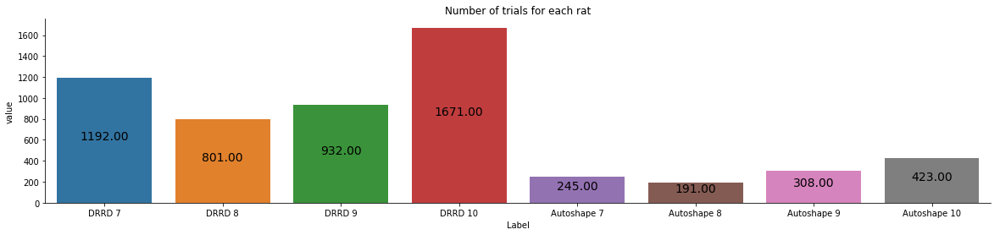

In [19]:
n_trials = [io.load(rat, 'behavior').shape[0] for rat in ALL_RATS]
n_trials = pd.DataFrame({'Number of trials':n_trials}, index=pd.Index(ALL_RATS, name='Label')).reset_index().melt(id_vars=['Label'])


ax = sns.barplot(x='Label',y='value', data=n_trials)

# Put numbers in bars
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height/2 + 3,
            '{:1.2f}'.format(height),
            ha="center", fontsize=14) 
    
sns.despine()
plt.title('Number of trials for each rat');

## Raster plots

### TODO

TODO:

    CHANGE ylim to start and stop correctly

### DRRD 7

In [6]:
rat = 'DRRD 7'
epoched = io.load(rat, 'epoched_spikes')

epoched['session'] = -1*(epoched.index<100) + (epoched.index>(epoched.index.max()-100))
epoched = epoched.reset_index().drop(['with_baseline', 'duration', 'onset', 'offset'], axis=1).melt(['trial','unit','session', 'is_selected'], value_name='time')

#### Selected 

In [9]:
to_plot = select(epoched, is_selected=True)

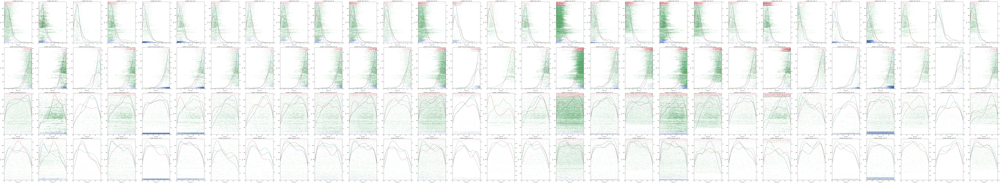

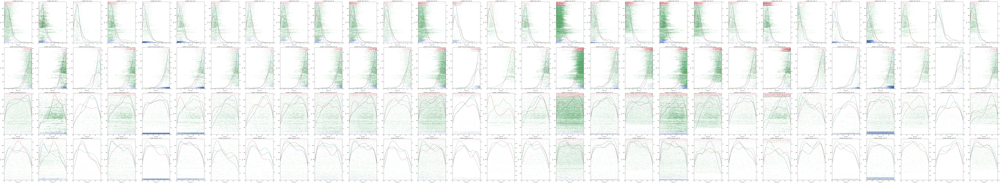

In [ ]:
raster_multiple(to_plot, hue='session',col='unit',row='variable', density=True, s=.5,alpha=.7, sharey=True,
                rows = ['time', 'time_from_offset', 'normalized_time', 'baseline'],
                xlim = [(0,7),  (-7,0),              (0,1),             (-.5,0)])

#### Removed

In [ ]:
to_plot = select(epoched, is_selected=False)
raster_multiple(to_plot, hue='session',col='unit',row='variable', density=True, s=.5,alpha=.7, sharey=True,
                rows = ['time', 'time_from_offset', 'normalized_time', 'baseline'],
                xlim = [(0,7),  (-7,0),              (0,1),             (-.5,0)])

/home/tevo/anaconda3/lib/python3.6/site-packages/numpy/core/_methods.py:135: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
/home/tevo/anaconda3/lib/python3.6/site-packages/numpy/core/_methods.py:127: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


### DRRD 8

In [ ]:
rat = 'DRRD 8'
epoched = io.load(rat, 'epoched_spikes')

epoched['session'] = -1*(epoched.index<100) + (epoched.index>(epoched.index.max()-100))
epoched = epoched.reset_index().drop(['with_baseline', 'duration', 'onset', 'offset'], axis=1).melt(['trial','unit','session', 'is_selected'], value_name='time')

#### Selected 

In [ ]:
to_plot = select(epoched, is_selected=True)
raster_multiple(to_plot, hue='session',col='unit',row='variable', density=True, s=.5,alpha=.7, sharey=True,
                rows = ['time', 'time_from_offset', 'normalized_time', 'baseline'],
                xlim = [(0,7),  (-7,0),              (0,1),             (-.5,0)])

#### Removed

In [ ]:
to_plot = select(epoched, is_selected=False)
raster_multiple(to_plot, hue='session',col='unit',row='variable', density=True, s=.5,alpha=.7, sharey=True,
                rows = ['time', 'time_from_offset', 'normalized_time', 'baseline'],
                xlim = [(0,7),  (-7,0),              (0,1),             (-.5,0)])

### DRRD 9

In [ ]:
rat = 'DRRD 9'
epoched = io.load(rat, 'epoched_spikes')

epoched['session'] = -1*(epoched.index<100) + (epoched.index>(epoched.index.max()-100))
epoched = epoched.reset_index().drop(['with_baseline', 'duration', 'onset', 'offset'], axis=1).melt(['trial','unit','session', 'is_selected'], value_name='time')

#### Selected 

In [ ]:
to_plot = select(epoched, is_selected=True)
raster_multiple(to_plot, hue='session',col='unit',row='variable', density=True, s=.5,alpha=.7, sharey=True,
                rows = ['time', 'time_from_offset', 'normalized_time', 'baseline'],
                xlim = [(0,7),  (-7,0),              (0,1),             (-.5,0)])

#### Removed

In [ ]:
to_plot = select(epoched, is_selected=False)
raster_multiple(to_plot, hue='session',col='unit',row='variable', density=True, s=.5,alpha=.7, sharey=True,
                rows = ['time', 'time_from_offset', 'normalized_time', 'baseline'],
                xlim = [(0,7),  (-7,0),              (0,1),             (-.5,0)])

### DRRD 10

In [ ]:
rat = 'DRRD 10'
epoched = io.load(rat, 'epoched_spikes')

epoched['session'] = -1*(epoched.index<100) + (epoched.index>(epoched.index.max()-100))
epoched = epoched.reset_index().drop(['with_baseline', 'duration', 'onset', 'offset'], axis=1).melt(['trial','unit','session', 'is_selected'], value_name='time')

#### Selected 

In [ ]:
to_plot = select(epoched, is_selected=True)
raster_multiple(to_plot, hue='session',col='unit',row='variable', density=True, s=.5,alpha=.7, sharey=True,
                rows = ['time', 'time_from_offset', 'normalized_time', 'baseline'],
                xlim = [(0,7),  (-7,0),              (0,1),             (-.5,0)])

#### Removed

In [ ]:
to_plot = select(epoched, is_selected=False)
raster_multiple(to_plot, hue='session',col='unit',row='variable', density=True, s=.5,alpha=.7, sharey=True,
                rows = ['time', 'time_from_offset', 'normalized_time', 'baseline'],
                xlim = [(0,7),  (-7,0),              (0,1),             (-.5,0)])

### Autoshape 7

In [ ]:
rat = 'Autoshape 7'
epoched = io.load(rat, 'epoched_spikes')

epoched['session'] = -1*(epoched.index<100) + (epoched.index>(epoched.index.max()-100))
epoched = epoched.reset_index().drop(['with_baseline', 'duration', 'onset', 'offset'], axis=1).melt(['trial','unit','session', 'is_selected'], value_name='time')

In [ ]:
raster_multiple(epoched, hue='session',col='unit',row='variable', density=True, s=.5,alpha=.7, sharey=True,
                rows = ['time', 'time_from_offset', 'normalized_time', 'baseline'],
                xlim = [(0,7),  (-7,0),              (0,1),             (-.5,0)])

### Autoshape 8

In [ ]:
rat = 'Autoshape 8'
epoched = io.load(rat, 'epoched_spikes')

epoched['session'] = -1*(epoched.index<100) + (epoched.index>(epoched.index.max()-100))
epoched = epoched.reset_index().drop(['with_baseline', 'duration', 'onset', 'offset'], axis=1).melt(['trial','unit','session', 'is_selected'], value_name='time')

In [ ]:
raster_multiple(epoched, hue='session',col='unit',row='variable', density=True, s=1,alpha=.7, sharey=True,
                rows = ['time', 'time_from_offset', 'normalized_time', 'baseline'],
                xlim = [(0,7),  (-7,0),              (0,1),             (-.5,0)])

### Autoshape 9

In [ ]:
rat = 'Autoshape 9'
epoched = io.load(rat, 'epoched_spikes')

epoched['session'] = -1*(epoched.index<100) + (epoched.index>(epoched.index.max()-100))
epoched = epoched.reset_index().drop(['with_baseline', 'duration', 'onset', 'offset'], axis=1).melt(['trial','unit','session', 'is_selected'], value_name='time')

In [ ]:
raster_multiple(epoched, hue='session',col='unit',row='variable', density=True, s=1,alpha=.7, sharey=True,
                rows = ['time', 'time_from_offset', 'normalized_time', 'baseline'],
                xlim = [(0,7),  (-7,0),              (0,1),             (-.5,0)])

### Autoshape 10

In [ ]:
rat = 'Autoshape 10'
epoched = io.load(rat, 'epoched_spikes')

epoched['session'] = -1*(epoched.index<100) + (epoched.index>(epoched.index.max()-100))
epoched = epoched.reset_index().drop(['with_baseline', 'duration', 'onset', 'offset'], axis=1).melt(['trial','unit','session', 'is_selected'], value_name='time')

In [ ]:
raster_multiple(epoched, hue='session',col='unit',row='variable', density=True, s=1,alpha=.7, sharey=True,
                rows = ['time', 'time_from_offset', 'normalized_time', 'baseline'],
                xlim = [(0,7),  (-7,0),              (0,1),             (-.5,0)])

## Interspike Intervals

### DRRD 7

In [36]:
label = 'DRRD 7'
epoched = io.load(label, 'epoched_spikes')
manual = select(epoched, is_selected=True)

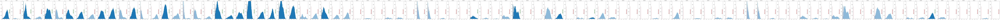

In [37]:
data = epoched.reset_index().set_index('unit')
units = data.index.unique()

plt.figure(figsize=(3*len(units), 6))
for i, _unit in enumerate(units):
    ax = plt.subplot(1, len(units), i+1)
    
    if data.loc[_unit, 'is_selected'].values[0]: 
        alpha = 1;
        ax.text(0,500, 'Selected', color='g', fontsize=20, rotation=90)
        
    else: 
        alpha = .5
        ax.text(0,500, 'Removed', color='r', fontsize=20, rotation=90)
    
    ax.hist(np.log10(np.hstack(data.loc[_unit].time.apply(np.diff).values)),'auto', alpha=alpha);
    
    plt.title('Unit %d'%_unit); plt.xlim([-3,.5]); plt.ylim([0,1000])
    plt.vlines(np.log10(.002), 0, 700, colors='r', linestyles='--')
plt.tight_layout()

### DRRD 8

In [38]:
label = 'DRRD 8'
epoched = io.load(label, 'epoched_spikes')
manual = select(epoched, is_selected=True)

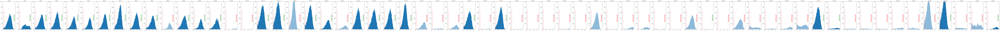

In [39]:
data = epoched.reset_index().set_index('unit')
units = data.index.unique()

plt.figure(figsize=(3*len(units), 6))
for i, _unit in enumerate(units):
    ax = plt.subplot(1, len(units), i+1)
    
    if data.loc[_unit, 'is_selected'].values[0]: 
        alpha = 1;
        ax.text(0,500, 'Selected', color='g', fontsize=20, rotation=90)
        
    else: 
        alpha = .5
        ax.text(0,500, 'Removed', color='r', fontsize=20, rotation=90)
    
    ax.hist(np.log10(np.hstack(data.loc[_unit].time.apply(np.diff).values)),'auto', alpha=alpha);
    
    plt.title('Unit %d'%_unit); plt.xlim([-3,.5]); plt.ylim([0,1000])
    plt.vlines(np.log10(.002), 0, 700, colors='r', linestyles='--')
plt.tight_layout()

### DRRD 9

In [40]:
label = 'DRRD 9'
epoched = io.load(label, 'epoched_spikes')
manual = select(epoched, is_selected=True)

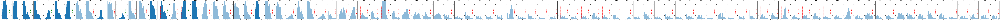

In [41]:
data = epoched.reset_index().set_index('unit')
units = data.index.unique()

plt.figure(figsize=(3*len(units), 6))
for i, _unit in enumerate(units):
    ax = plt.subplot(1, len(units), i+1)
    
    if data.loc[_unit, 'is_selected'].values[0]: 
        alpha = 1;
        ax.text(0,500, 'Selected', color='g', fontsize=20, rotation=90)
        
    else: 
        alpha = .5
        ax.text(0,500, 'Removed', color='r', fontsize=20, rotation=90)
    
    ax.hist(np.log10(np.hstack(data.loc[_unit].time.apply(np.diff).values)),'auto', alpha=alpha);
    
    plt.title('Unit %d'%_unit); plt.xlim([-3,.5]); plt.ylim([0,1000])
    plt.vlines(np.log10(.002), 0, 700, colors='r', linestyles='--')
plt.tight_layout()

### DRRD 10

In [42]:
label = 'DRRD 10'
epoched = io.load(label, 'epoched_spikes')
manual = select(epoched, is_selected=True)

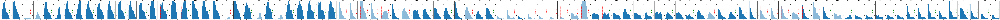

In [43]:
data = epoched.reset_index().set_index('unit')
units = data.index.unique()

plt.figure(figsize=(3*len(units), 6))
for i, _unit in enumerate(units):
    ax = plt.subplot(1, len(units), i+1)
    
    if data.loc[_unit, 'is_selected'].values[0]: 
        alpha = 1;
        ax.text(0,500, 'Selected', color='g', fontsize=20, rotation=90)
        
    else: 
        alpha = .5
        ax.text(0,500, 'Removed', color='r', fontsize=20, rotation=90)
    
    ax.hist(np.log10(np.hstack(data.loc[_unit].time.apply(np.diff).values)),'auto', alpha=alpha);
    
    plt.title('Unit %d'%_unit); plt.xlim([-3,.5]); plt.ylim([0,1000])
    plt.vlines(np.log10(.002), 0, 700, colors='r', linestyles='--')
plt.tight_layout()

### Autoshape 7

In [44]:
label = 'Autoshape 7'
epoched = io.load(label, 'epoched_spikes')
manual = select(epoched, is_selected=True)

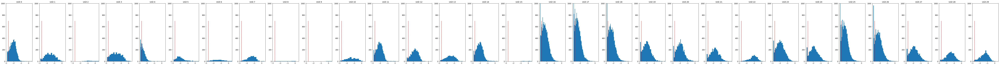

In [45]:
data = epoched.reset_index().set_index('unit')
units = data.index.unique()

plt.figure(figsize=(3*len(units), 6))
for i, _unit in enumerate(units):
    ax = plt.subplot(1, len(units), i+1)
    
    alpha=1
    
    ax.hist(np.log10(np.hstack(data.loc[_unit].time.apply(np.diff).values)),'auto', alpha=alpha);
    
    plt.title('Unit %d'%_unit); plt.xlim([-3,.5]); plt.ylim([0,1000])
    plt.vlines(np.log10(.002), 0, 700, colors='r', linestyles='--')
plt.tight_layout()

### Autoshape 8

In [46]:
label = 'Autoshape 8'
epoched = io.load(label, 'epoched_spikes')
manual = select(epoched, is_selected=True)

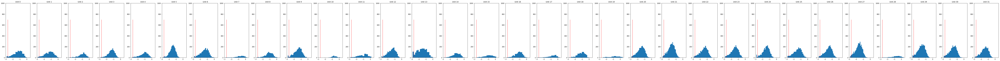

In [47]:
data = epoched.reset_index().set_index('unit')
units = data.index.unique()

plt.figure(figsize=(3*len(units), 6))
for i, _unit in enumerate(units):
    ax = plt.subplot(1, len(units), i+1)
    
    alpha=1
    
    ax.hist(np.log10(np.hstack(data.loc[_unit].time.apply(np.diff).values)),'auto', alpha=alpha);
    
    plt.title('Unit %d'%_unit); plt.xlim([-3,.5]); plt.ylim([0,1000])
    plt.vlines(np.log10(.002), 0, 700, colors='r', linestyles='--')
plt.tight_layout()

### Autoshape 9

In [48]:
label = 'Autoshape 9'
epoched = io.load(label, 'epoched_spikes')
manual = select(epoched, is_selected=True)

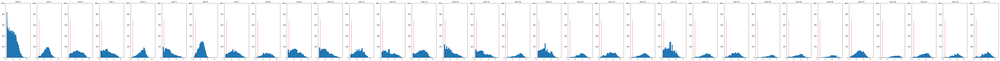

In [49]:
data = epoched.reset_index().set_index('unit')
units = data.index.unique()

plt.figure(figsize=(3*len(units), 6))
for i, _unit in enumerate(units):
    ax = plt.subplot(1, len(units), i+1)
    
    alpha=1
    
    ax.hist(np.log10(np.hstack(data.loc[_unit].time.apply(np.diff).values)),'auto', alpha=alpha);
    
    plt.title('Unit %d'%_unit); plt.xlim([-3,.5]); plt.ylim([0,1000])
    plt.vlines(np.log10(.002), 0, 700, colors='r', linestyles='--')
plt.tight_layout()

### Autoshape 10

In [50]:
label = 'Autoshape 10'
epoched = io.load(label, 'epoched_spikes')
manual = select(epoched)

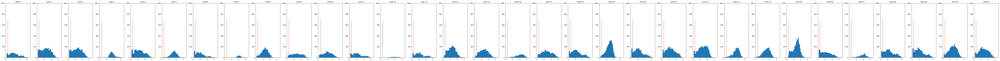

In [51]:
data = epoched.reset_index().set_index('unit')
units = data.index.unique()

plt.figure(figsize=(3*len(units), 6))
for i, _unit in enumerate(units):
    ax = plt.subplot(1, len(units), i+1)
    
    alpha=1
    
    ax.hist(np.log10(np.hstack(data.loc[_unit].time.apply(np.diff).values)),'auto', alpha=alpha);
    
    plt.title('Unit %d'%_unit); plt.xlim([-3,.5]); plt.ylim([0,1000])
    plt.vlines(np.log10(.002), 0, 700, colors='r', linestyles='--')
plt.tight_layout()

## Time-resolved analysis

In [94]:
unit_trial = epoched.reset_index().set_index(['unit','trial'])

In [166]:
unit_trial['timecount'] = unit_trial.apply(time_activity, window=.1, lim=unit_trial.duration.max(), axis=1).time

In [169]:
unit_trial['timenorm'] = unit_trial.apply(time_activity, nbins=10, axis=1).time

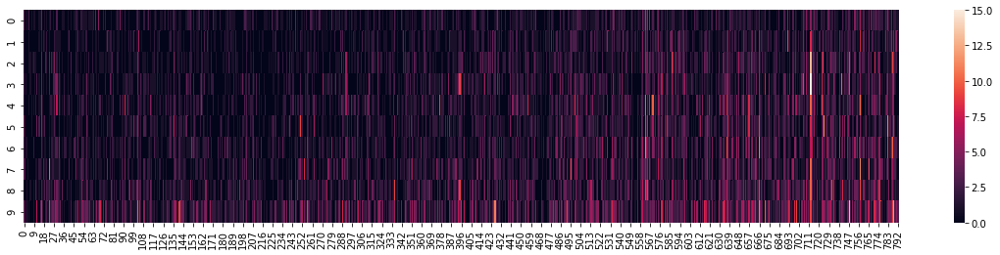

In [232]:
sns.heatmap(np.vstack(unit_trial.timenorm[6].values).transpose())

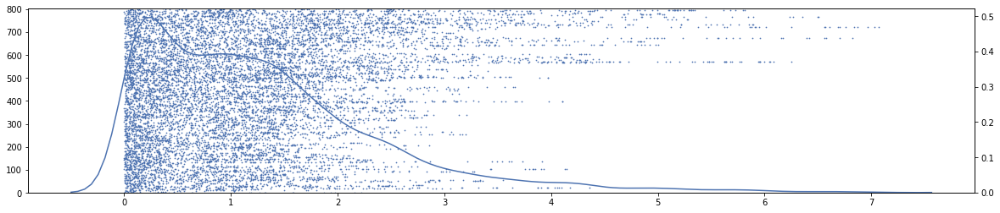

In [210]:
raster_plot(unit_trial.loc[0].reset_index(), s=.5, density=True)

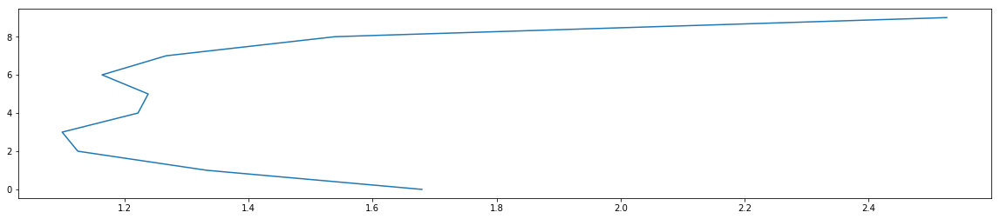

In [193]:
plt.plot(np.vstack(unit_trial.timenorm[0].values).transpose().mean(axis=1), range(10))

In [165]:
def time_activity(row, window=None, nbins=None, lim='auto'):
    if lim=='auto':
        range = (0, row.duration)
    else:
        range = (0, lim)
    if nbins is None:
        nbins = int(range[1]/window)
    else:
        assert window is None
    
    count, _ = np.histogram(row.time, bins = nbins, range=range)
    return [count]

### Duration

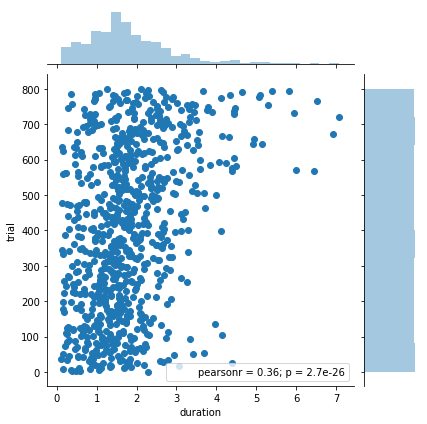

In [96]:
sns.jointplot('duration', 'trial', tdv)

In [134]:
tdv = r.groupby('unit').get_group(6).reset_index().melt(id_vars=['trial','duration'],value_vars='time')

In [135]:
aux = pd.DataFrame()
for i, row in tdv.iterrows():
    aux = pd.concat((aux, pd.DataFrame(np.diff(row.value), columns=[row.duration]).reset_index()))    

durisi = aux.drop('index',axis=1).melt().dropna()

In [136]:
duril = durisi.copy()
duril['time'] = duril['value'].apply(np.log)

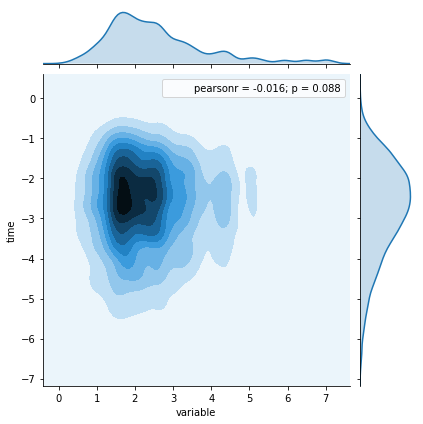

In [137]:
sns.jointplot('variable', 'time', data=duril, kind='kde')

## Firing rate

In [ ]:
import spykeutils as su
import spykeutils.rate_estimation as sr
import neo
import numpy as np
import quantities as q

In [ ]:
x = np.random.exponential(1,1000).cumsum()

In [ ]:
sr.optimal_gauss_kernel_size(neo.SpikeTrain(x*q.s, x[-1]*q.s),np.array([1,3,5,19,30,35,40,50,80,300,3000,3e4,3e5,3e6])*q.s)

### Per neuron

### Baseline

### Per trial

### Per time

# Synchronicity

## Cross-correlation

## Distances

### ISI-Distance

In [37]:
import pyspike as spk

In [284]:
epoched = io.load('DRRD 8', 'epoched_spikes')
s = io.load('DRRD 8', 'selected_neurons')
epoched = select(r, unit_in_=np.nonzero(s)[0], _min_duration=1, _max_duration=3)

In [285]:
def trial_to_trains(data, trial):
    trains = [spk.SpikeTrain(times, (0, r.duration[trial].values[0])) for times in r.loc[trial].time.values]
    return trains

In [290]:
X = np.stack(spk.isi_distance_matrix(trial_to_trains(epoched, t), interval=(0,1)) for t in epoched.index.unique())

/home/tevo/anaconda3/lib/python3.6/site-packages/seaborn/matrix.py:603: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  metric=self.metric)


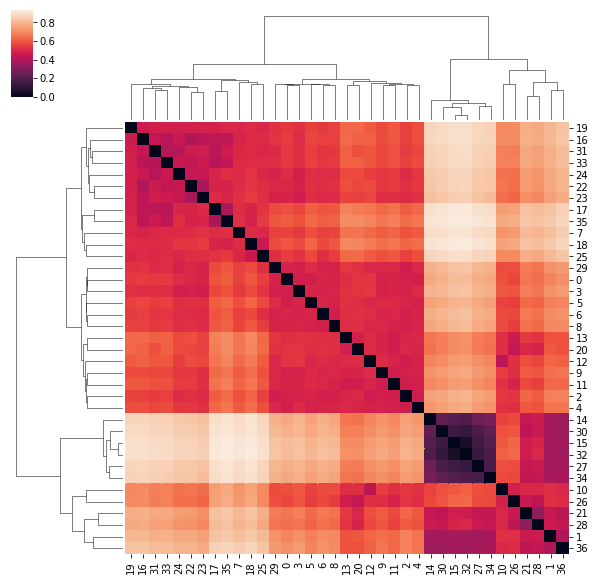

In [291]:
ax = sns.clustermap(X.mean(axis=0))

In [292]:
X = np.stack(spk.spike_distance_matrix(trial_to_trains(epoched, t), interval=(0,1)) for t in epoched.index.unique())

/home/tevo/anaconda3/lib/python3.6/site-packages/seaborn/matrix.py:603: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  metric=self.metric)


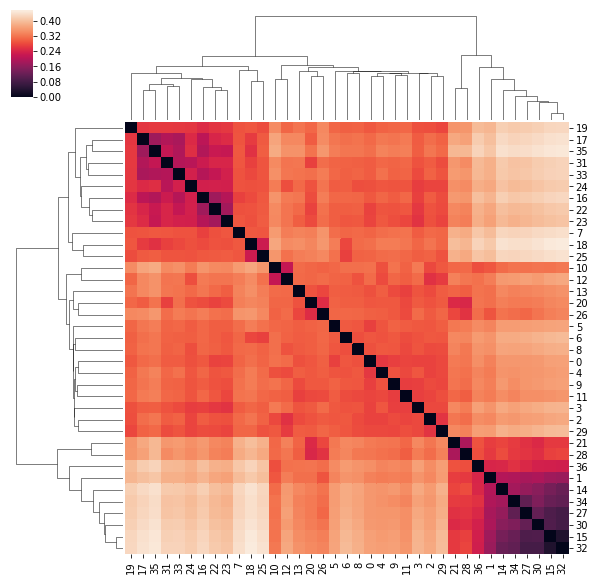

In [293]:
ax = sns.clustermap(X.mean(axis=0))

In [294]:
X = np.stack(spk.spike_sync_matrix(trial_to_trains(epoched, t), interval=(0,1)) for t in epoched.index.unique())

/home/tevo/anaconda3/lib/python3.6/site-packages/seaborn/matrix.py:603: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  metric=self.metric)


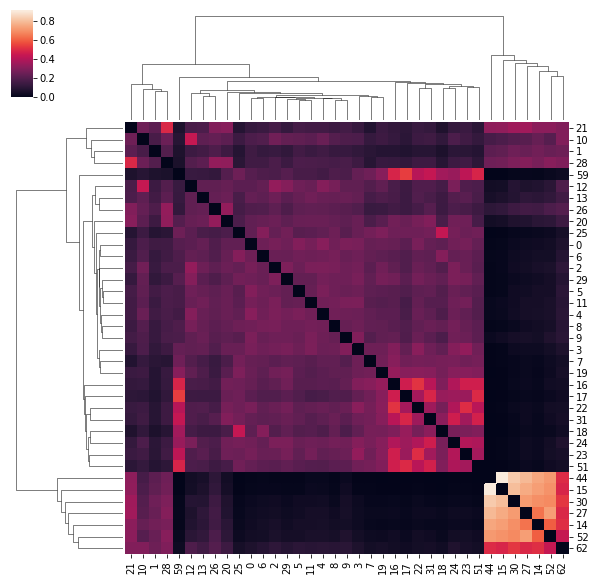

In [298]:
Xdf = pd.DataFrame(X.mean(axis=0),index=epoched.unit.unique(),columns=epoched.unit.unique())
ax = sns.clustermap(Xdf)

##### Baseline

##### Trials < 1s

##### Trials $\in [1s,2s]$

##### Trials $\in [2s,+\infty[$

### Spike-Distance

##### Baseline

##### Trials < 1s

##### Trials $\in [1s,2s]$

##### Trials $\in [2s,+\infty[$